# Problem Description

Predict the house price based on the given attributes using regression with the following approaches. 

1. Univariate
2. Multivariate
3. Polynomial
4. Univariate with Normalization
5. Polynomial with Normalization


# <b>Data Description:</b>

1. Id - Unique ID for each home sold
2. date - Date of the home sale
3. price - Price of each home sold
4. bedrooms - Number of bedrooms
5. bathrooms - Number of bathrooms, where .5 accounts for a room with a toilet but no shower
6. sqft_living - Square footage of the apartments interior living space
7. sqft_lot - Square footage of the land space
8. floors - Number of floors
9. waterfront - A dummy variable for whether the apartment was overlooking the waterfront or not
10. view - An index from 0 to 4 of how good the view of the property was
11. condition - An index from 1 to 5 on the condition of the apartment,
12. grade - An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.
13. sqft_above - The square footage of the interior housing space that is above ground level
14. sqft_basement - The square footage of the interior housing space that is below ground level
15. yr_built - The year the house was initially built
16. yr_renovated - The year of the house’s last renovation
17. zipcode - What zipcode area the house is in
18. lat - Lattitude
19. long - Longitude
20. sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors
21. sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors


Here, Price is our dependant variable


# Contents

1. [Loading Libraries](#1.-Loading-Libraries)
2. [Loading Data](#2.-Loading-Data)
3. [Data preparation and Visualizations](#3.-Data-preparation-and-Visualizations)
    1. [Checking Datatypes and Description of Data](#1.-Checking-Datatypes-and-Description-of-Data)
    2. [Finding Null Values](#2.-Finding-Null-Values)
    3. [Id Vs Price](#3.-ID-with-Price)
    4. [Bedrooms Vs Price](#4.-Bedrooms-Vs-Price)
    5. [Bathrooms vs Price](#5.-Bathrooms-vs-Price)
    6. [Price vs SqftLiving](#6.-Price-vs-SqftLiving)
    7. [Price vs SqftLot](#7.-Price-vs-SqftLot)
    8. [Floors vs Price](#8.-Floors-vs-Price)
    9. [Waterfront vs Price](#9.-Waterfront)
    10. [View vs Price](#10.-View-vs-Price)
    11. [Condition vs Price](#11.-Condition-vs-Price)
    12. [Grade vs Price](#12.-Grade-vs-Price)
    13. [Sqft Above vs Price](#13.-Sqft-Above-vs-Price)
    14. [Sqft Basement vs Price](#14.-Sqft-Basement-vs-Price)
    15. [Yr_built vs Price](#15.-Yr_built-vs-Price)
    16. [Yr_renovated vs Price](#16.-Yr_renovated-vs-Price)
    17. [Zipcode vs Price](#17.-Zipcode-vs-Price)
    18. [Lat Long Visualization](#18.-Lat-Long)
    19. [Sqft_living15](#19.-Sqft_living15)
    20. [Sqft_lot15](#20.-Sqft_lot15)
4. [Feature Engineering](#4.-Feature-Engineering)
    1. [Overview of the above Data Preparation](#1.-Overview-of-the-above-Data-Preparation)
    2. [Analysing the data](#2.-Analysing-the-data)
    3. [Year Built and Renovated](#3.-Year-Built-and-Renovated)
5. [Model Preparation](#5.-Model-Preparation)
    1. [Univariate Model](#1.-Univariate-Model)
    2. [Multivariate](#2.-Multivariate)
    3. [Polynomial](#3.-Polynomial)
    4. [Univariate with Normalization](#4.-Univariate-with-Normalization)
    5. [Polynomial Normalization with Regression](#5.-Polynomial-Normalization-with-Regression)
6. [Inference](#Inference:)
7. [Unexplored Options](#Unexplored-Options:)

In [1]:
%pip install pandas

Note: you may need to restart the kernel to use updated packages.


# 1. Loading Libraries

In [4]:
import pandas as pd # For Data Visualization
import numpy as np # For Numerical activities

import matplotlib.pyplot as plt # For Visualization
import seaborn as sns # For Visualization
import folium # For Map Visualization

plt.style.use('fivethirtyeight') # For Nice Viz

from sklearn.preprocessing import StandardScaler, MinMaxScaler


In [5]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

# 2. Loading Data

In [6]:
df = pd.read_csv("kc_house_data.csv")

In [7]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


# 3. Data preparation and Visualizations

## 1. Checking Datatypes and Description of Data

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [6]:
df.date = pd.to_datetime(df.date)

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21613 non-null  int64         
 1   date           21613 non-null  datetime64[ns]
 2   price          21613 non-null  float64       
 3   bedrooms       21613 non-null  int64         
 4   bathrooms      21613 non-null  float64       
 5   sqft_living    21613 non-null  int64         
 6   sqft_lot       21613 non-null  int64         
 7   floors         21613 non-null  float64       
 8   waterfront     21613 non-null  int64         
 9   view           21613 non-null  int64         
 10  condition      21613 non-null  int64         
 11  grade          21613 non-null  int64         
 12  sqft_above     21613 non-null  int64         
 13  sqft_basement  21613 non-null  int64         
 14  yr_built       21613 non-null  int64         
 15  yr_renovated   2161

In [8]:
df.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,2.161300e+04,2.161300e+04,21613.000000,21613.000000,21613.000000,2.161300e+04,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000,21613.000000
mean,4.580302e+09,5.400881e+05,3.370842,2.114757,2079.899736,1.510697e+04,1.494309,0.007542,0.234303,3.409430,7.656873,1788.390691,291.509045,1971.005136,84.402258,98077.939805,47.560053,-122.213896,1986.552492,12768.455652
std,2.876566e+09,3.671272e+05,0.930062,0.770163,918.440897,4.142051e+04,0.539989,0.086517,0.766318,0.650743,1.175459,828.090978,442.575043,29.373411,401.679240,53.505026,0.138564,0.140828,685.391304,27304.179631
min,1.000102e+06,7.500000e+04,0.000000,0.000000,290.000000,5.200000e+02,1.000000,0.000000,0.000000,1.000000,1.000000,290.000000,0.000000,1900.000000,0.000000,98001.000000,47.155900,-122.519000,399.000000,651.000000
25%,2.123049e+09,3.219500e+05,3.000000,1.750000,1427.000000,5.040000e+03,1.000000,0.000000,0.000000,3.000000,7.000000,1190.000000,0.000000,1951.000000,0.000000,98033.000000,47.471000,-122.328000,1490.000000,5100.000000
50%,3.904930e+09,4.500000e+05,3.000000,2.250000,1910.000000,7.618000e+03,1.500000,0.000000,0.000000,3.000000,7.000000,1560.000000,0.000000,1975.000000,0.000000,98065.000000,47.571800,-122.230000,1840.000000,7620.000000
75%,7.308900e+09,6.450000e+05,4.000000,2.500000,2550.000000,1.068800e+04,2.000000,0.000000,0.000000,4.000000,8.000000,2210.000000,560.000000,1997.000000,0.000000,98118.000000,47.678000,-122.125000,2360.000000,10083.000000
max,9.900000e+09,7.700000e+06,33.000000,8.000000,13540.000000,1.651359e+06,3.500000,1.000000,4.000000,5.000000,13.000000,9410.000000,4820.000000,2015.000000,2015.000000,98199.000000,47.777600,-121.315000,6210.000000,871200.000000


## 2. Finding Null Values

In [9]:
df.isnull().sum()

id               0
date             0
price            0
bedrooms         0
bathrooms        0
sqft_living      0
sqft_lot         0
floors           0
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

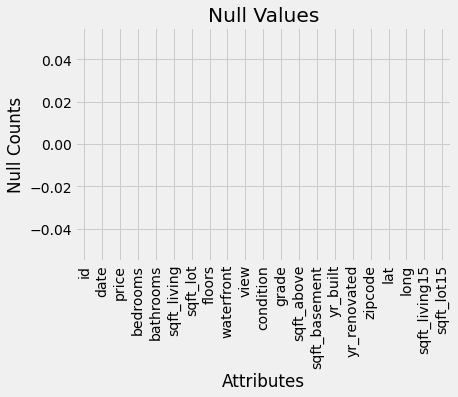

In [10]:
df.isnull().sum().plot(kind='bar')
plt.title("Null Values")
plt.xlabel("Attributes")
plt.ylabel("Null Counts")
plt.show()

#### Inference: 
There are no null values present in the data. 

## 3. ID with Price

 Unique ID for each home sold

In [11]:
id_vs_price = df[["id","price"]].copy()

In [12]:
id_vs_price

,id,price
0,7129300520,221900.0
1,6414100192,538000.0
2,5631500400,180000.0
3,2487200875,604000.0
4,1954400510,510000.0
...,...,...
21608,263000018,360000.0
21609,6600060120,400000.0
21610,1523300141,402101.0
21611,291310100,400000.0


In [13]:
norm = MinMaxScaler()
id_vs_price["id"] = norm.fit_transform(id_vs_price[["id"]])

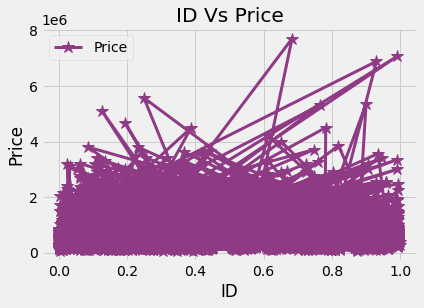

In [14]:
plt.plot(id_vs_price['id'], id_vs_price['price'], 
         color='#8f3a84', marker='*', linestyle='solid', 
         markersize=12, linewidth=3, label="Price")
plt.xlabel("ID")
plt.ylabel("Price")
plt.legend()
plt.title("ID Vs Price")
plt.show()

<AxesSubplot:xlabel='price', ylabel='id'>

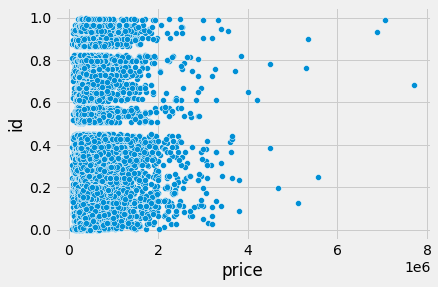

In [15]:
sns.scatterplot(data=id_vs_price, x="price", y="id")

From the above plot, its clear like its not having a good relationship. The price remains the same for any id (more of a static value)

In [16]:
id_vs_price.corr()

,id,price
id,1.000000,-0.016762
price,-0.016762,1.000000


#### Inference: 
From the above we can see id and price is not having a good relationship. So we can ignore that. 

In [17]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15'], dtype='object')

## 4. Bedrooms Vs Price

Number of bedrooms

In [18]:
# Range of Bedrooms values
df.bedrooms.unique()

array([ 3,  2,  4,  5,  1,  6,  7,  0,  8,  9, 11, 10, 33])

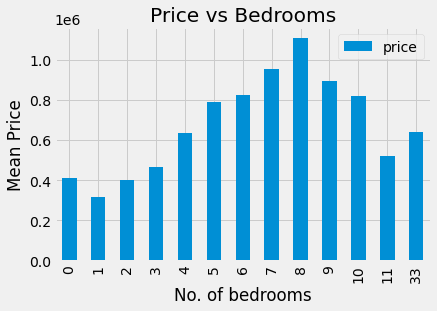

In [19]:
df.groupby('bedrooms').price.mean().plot(kind='bar')
plt.xlabel("No. of bedrooms")
plt.ylabel("Mean Price")
plt.title("Price vs Bedrooms")
plt.legend()

From the above plot, we can see that mean price of a house with bedrooms in the range 1-8 its increasing and then its decreasing. 

Text(0.5, 1.0, 'Bedrooms Distributions')

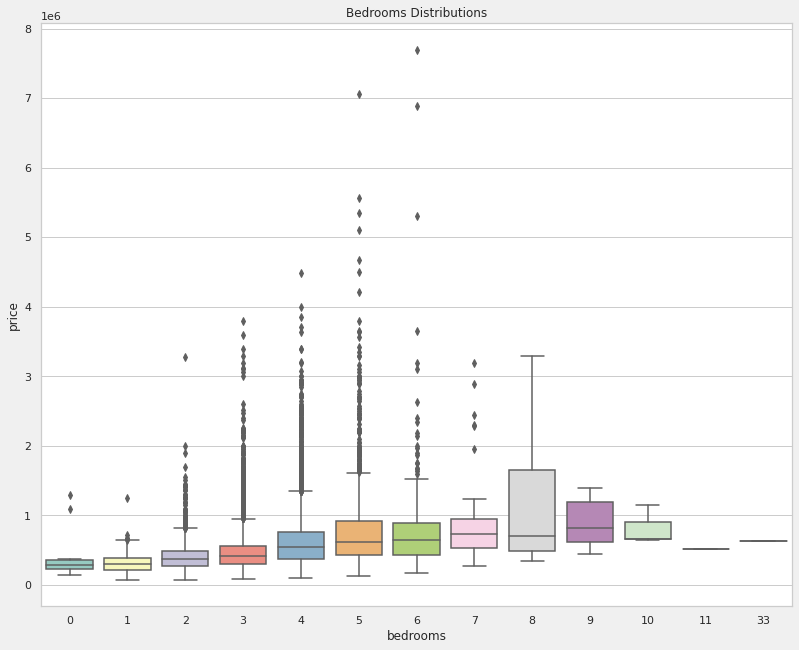

In [20]:
plt.figure(figsize=(12,10))
sns.set_theme(style="whitegrid")
sns.boxplot(x="bedrooms", y="price", data=df, palette="Set3")
plt.title("Bedrooms Distributions")

Text(0.5, 1.0, 'Price vs Bedrooms')

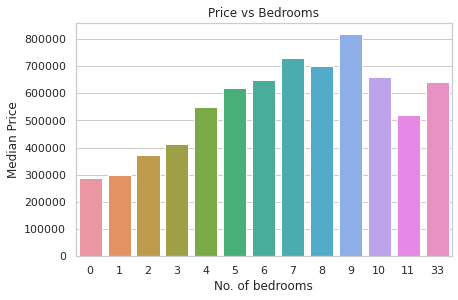

In [21]:
# With Mean
bedroom_price = df.groupby('bedrooms').price.median()
sns.barplot(x=bedroom_price.index, y=bedroom_price.values, dodge=False)
plt.xlabel("No. of bedrooms")
plt.ylabel("Median Price")
plt.title("Price vs Bedrooms")

In [22]:
df[["bedrooms","price"]].corr()

,bedrooms,price
bedrooms,1.00000,0.30835
price,0.30835,1.00000


#### Inference:
1. From the above we can see that we can <b> Median </b> Price is rising till 9 and dropping and raising again. So we can see futher whether the bedroom is also affected by some other values and we can change the values of these categorical values. 

2. Bedrooms is having a correlation of 0.30 

## 5. Bathrooms vs Price

Number of bathrooms, where .5 accounts for a room with a toilet but no shower

In [23]:
# Range of Bathrooms values
df.bathrooms.unique()

array([1.  , 2.25, 3.  , 2.  , 4.5 , 1.5 , 2.5 , 1.75, 2.75, 3.25, 4.  ,
       3.5 , 0.75, 4.75, 5.  , 4.25, 3.75, 0.  , 1.25, 5.25, 6.  , 0.5 ,
       5.5 , 6.75, 5.75, 8.  , 7.5 , 7.75, 6.25, 6.5 ])

In [24]:
bathroom_sort = df.bathrooms.value_counts().sort_index()

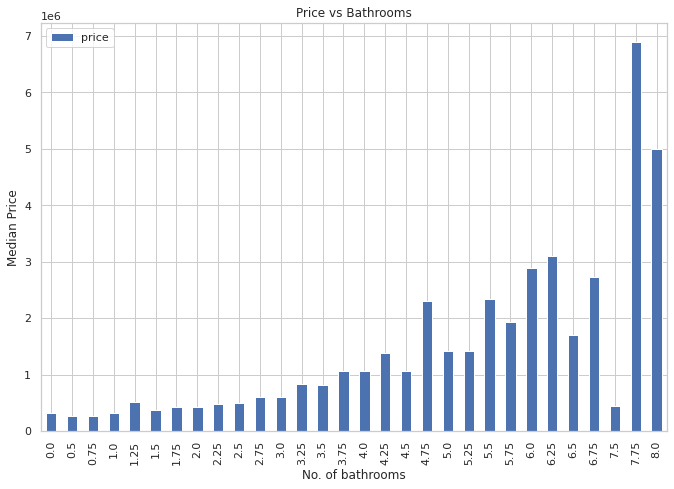

In [25]:
plt.figure(figsize=(10, 7))
df.groupby('bathrooms').price.median().plot(kind='bar')
plt.xlabel("No. of bathrooms")
plt.ylabel("Median Price")
plt.title("Price vs Bathrooms")
plt.legend()

From the above we can see that its gradually increasing, but at the end at 7.5 its dropping a lot (same as house with zero bathrooms)


From the above graph its suspecious that why a value is dropping and rising suddenly at range 5.0 to 8.0. We can try to find the total amount of items present in indivdual categories. 

In [26]:
bathroom_sort

0.00      10
0.50       4
0.75      72
1.00    3852
1.25       9
1.50    1446
1.75    3048
2.00    1930
2.25    2047
2.50    5380
2.75    1185
3.00     753
3.25     589
3.50     731
3.75     155
4.00     136
4.25      79
4.50     100
4.75      23
5.00      21
5.25      13
5.50      10
5.75       4
6.00       6
6.25       2
6.50       2
6.75       2
7.50       1
7.75       1
8.00       2
Name: bathrooms, dtype: int64

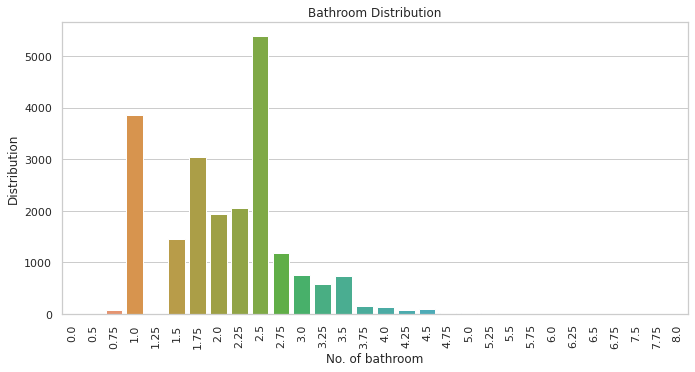

In [27]:
# Value Counts - Distribution
plt.figure(figsize=(10,5))
sns.barplot(x=bathroom_sort.index, y=bathroom_sort.values, dodge=False)
plt.xlabel("No. of bathroom")
plt.ylabel("Distribution")
plt.title("Bathroom Distribution")
plt.xticks(rotation=90)
plt.show()

Text(0.5, 1.0, 'Bathrooms Distributions')

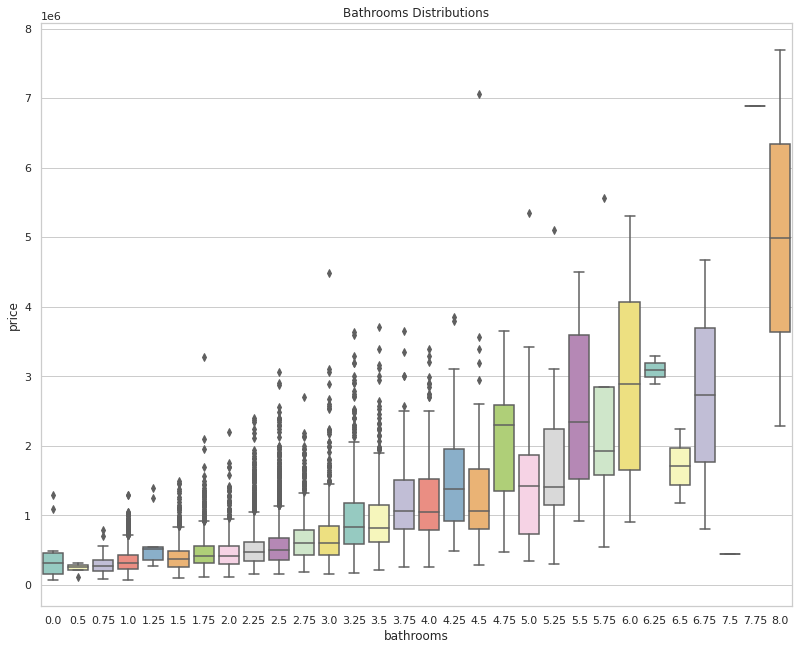

In [28]:
plt.figure(figsize=(12,10))
sns.set_theme(style="whitegrid")
sns.boxplot(x="bathrooms", y="price", data=df, palette="Set3")
plt.title("Bathrooms Distributions")

We can convert the these in to a categorical values. 

In [29]:
# Find the correlation of bathroom with price
df[['bathrooms','price']].corr()

,bathrooms,price
bathrooms,1.000000,0.525138
price,0.525138,1.000000


In [30]:
df["bathroom_category"] = df["bathrooms"].apply(lambda x: x if x<5.5 else 10)

In [31]:
# Find the correlation of bathroom with price
df[['bathroom_category','price']].corr()

,bathroom_category,price
bathroom_category,1.00000,0.53876
price,0.53876,1.00000


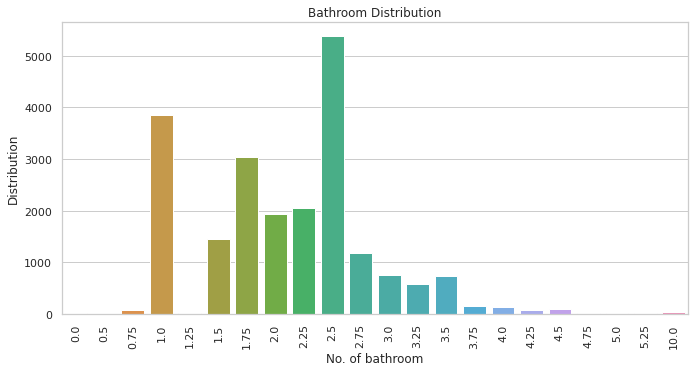

In [32]:
# Value Counts - Distribution
plt.figure(figsize=(10,5))
bathroom_sort = df.bathroom_category.value_counts().sort_index()
sns.barplot(x=bathroom_sort.index, y=bathroom_sort.values, dodge=False)
plt.xlabel("No. of bathroom")
plt.ylabel("Distribution")
plt.title("Bathroom Distribution")
plt.xticks(rotation=90)
plt.show()

### Bathroom vs Bedroom

In [33]:
df.groupby("bedrooms").bathrooms.value_counts().unstack()

bathrooms,0.00,0.50,0.75,1.00,1.25,1.50,1.75,2.00,2.25,2.50,2.75,3.00,3.25,3.50,3.75,4.00,4.25,4.50,4.75,5.00,5.25,5.50,5.75,6.00,6.25,6.50,6.75,7.50,7.75,8.00
bedrooms,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,7.0,NaN,1.0,1.0,NaN,1.0,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3.0,1.0,27.0,138.0,2.0,12.0,4.0,6.0,4.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,2.0,26.0,1558.0,3.0,294.0,304.0,216.0,118.0,197.0,20.0,13.0,8.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,16.0,1780.0,4.0,829.0,1870.0,1048.0,1082.0,2357.0,275.0,197.0,184.0,143.0,17.0,11.0,6.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,1.0,2.0,325.0,NaN,254.0,719.0,525.0,709.0,2502.0,639.0,326.0,254.0,395.0,78.0,58.0,38.0,32.0,7.0,7.0,5.0,5.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,43.0,NaN,48.0,134.0,110.0,116.0,287.0,214.0,163.0,129.0,169.0,44.0,48.0,25.0,35.0,11.0,7.0,4.0,4.0,2.0,4.0,2.0,1.0,1.0,NaN,NaN,NaN
6,NaN,NaN,NaN,6.0,NaN,6.0,16.0,24.0,15.0,29.0,31.0,45.0,12.0,17.0,13.0,11.0,8.0,23.0,3.0,6.0,3.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,1.0,1.0
7,NaN,NaN,NaN,1.0,NaN,2.0,NaN,NaN,3.0,2.0,3.0,3.0,1.0,5.0,2.0,5.0,2.0,3.0,2.0,NaN,NaN,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,3.0,2.0,1.0,1.0,1.0,2.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'bathroom_category'], dtype='object')

In [35]:
df.groupby("bedrooms").bathrooms.sum()

bedrooms
0        10.75
1       212.25
2      3868.75
3     19337.50
4     16767.50
5      4448.50
6       834.50
7       138.75
8        46.25
9        26.50
10       10.25
11        3.00
33        1.75
Name: bathrooms, dtype: float64

from the above we can see that, a house with 11 bedrooms is having only 3 bathrooms and a house with 33 bedrooms !
is having only 1.75 bathrooms . 


I Feel these are some outlier data so we can remove it. 

In [36]:
deletion_mask = (df.bedrooms.isin([11, 33]))

In [37]:
deletion_mask

0        False
1        False
2        False
3        False
4        False
         ...  
21608    False
21609    False
21610    False
21611    False
21612    False
Name: bedrooms, Length: 21613, dtype: bool

In [38]:
df.drop(df[deletion_mask].index,axis=0,inplace=True)

In [39]:
df.groupby("bedrooms").bathrooms.sum()

bedrooms
0        10.75
1       212.25
2      3868.75
3     19337.50
4     16767.50
5      4448.50
6       834.50
7       138.75
8        46.25
9        26.50
10       10.25
Name: bathrooms, dtype: float64

In [40]:
# Find the correlation of bathroom with price
df[['bathrooms','price']].corr()

,bathrooms,price
bathrooms,1.000000,0.525166
price,0.525166,1.000000


In [41]:
# Find the correlation of bathroom with price
df[['bathroom_category','price']].corr()

,bathroom_category,price
bathroom_category,1.000000,0.538787
price,0.538787,1.000000


#### Inference:
1. Bathrooms column is having a corr of 0.525
2. Newly generated bathroom_category column, There is a slight increase in corr (0.5387), we can keep it like this itself. 

## 6. Price vs SqftLiving

Square footage of the apartments interior living space

In [42]:
sqft_srs = df[['sqft_living','price']].sort_values(by='sqft_living')

In [43]:
sqft_df = sqft_srs.reset_index().drop('index',axis=1)

<AxesSubplot:xlabel='sqft_living', ylabel='price'>

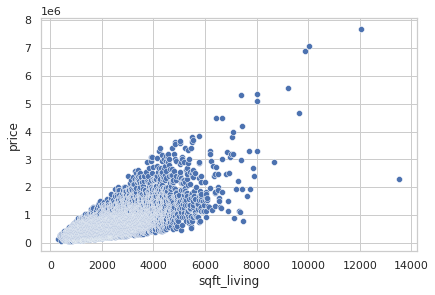

In [44]:
sns.scatterplot(data=sqft_df, x="sqft_living", y="price")

<AxesSubplot:xlabel='sqft_living', ylabel='price'>

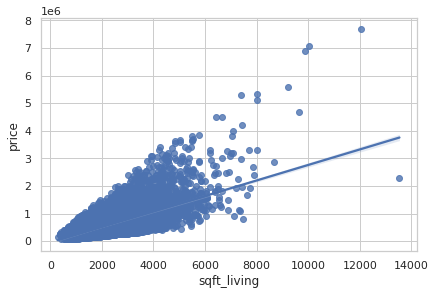

In [45]:
sns.regplot(x="sqft_living", y="price", data=sqft_df)

In [46]:
sqft_df.corr()

,sqft_living,price
sqft_living,1.000000,0.702066
price,0.702066,1.000000


#### Inference: 
Nice corealtion is existing between sqft_living and price (0.70)

## 7. Price vs SqftLot

Square footage of the land space

In [47]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'bathroom_category'], dtype='object')

In [48]:
sqft_srs = df[['sqft_lot','price']].sort_values(by='sqft_lot')

In [49]:
sqft_df = sqft_srs.reset_index().drop('index',axis=1)

<AxesSubplot:xlabel='sqft_lot', ylabel='price'>

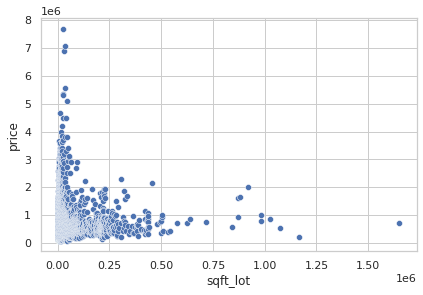

In [50]:
sns.scatterplot(data=sqft_df, x="sqft_lot", y="price")

<AxesSubplot:xlabel='sqft_lot', ylabel='price'>

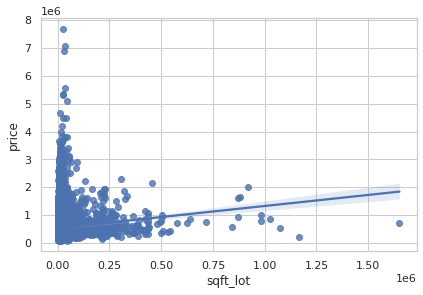

In [51]:
sns.regplot(x="sqft_lot", y="price", data=sqft_df)

In [52]:
sqft_df.corr()

,sqft_lot,price
sqft_lot,1.000000,0.089663
price,0.089663,1.000000


#### Inference 
Its having lower corelation, so we can ignore it. 

## 8. Floors vs Price

Floors - Number of floors

In [53]:
df.floors.unique()

array([1. , 2. , 1.5, 3. , 2.5, 3.5])

In [54]:
df.floors.value_counts()

1.0    10679
2.0     8240
1.5     1910
3.0      613
2.5      161
3.5        8
Name: floors, dtype: int64

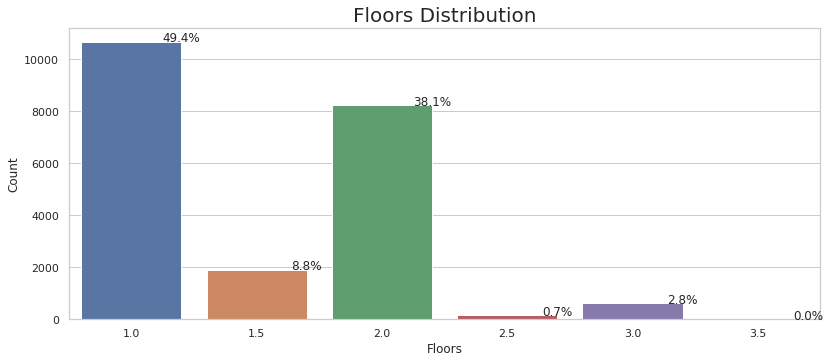

In [55]:
sns.set(style="whitegrid")
plt.figure(figsize=(12,5))

total = float(df.shape[0])

ax = sns.countplot(x="floors", data=df)
plt.title('Floors Distribution', fontsize=20)
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_height()/total)
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x, y),ha='center')
plt.xlabel("Floors")
plt.ylabel("Count")
plt.show()

Text(0.5, 1.0, 'Floors Distributions')

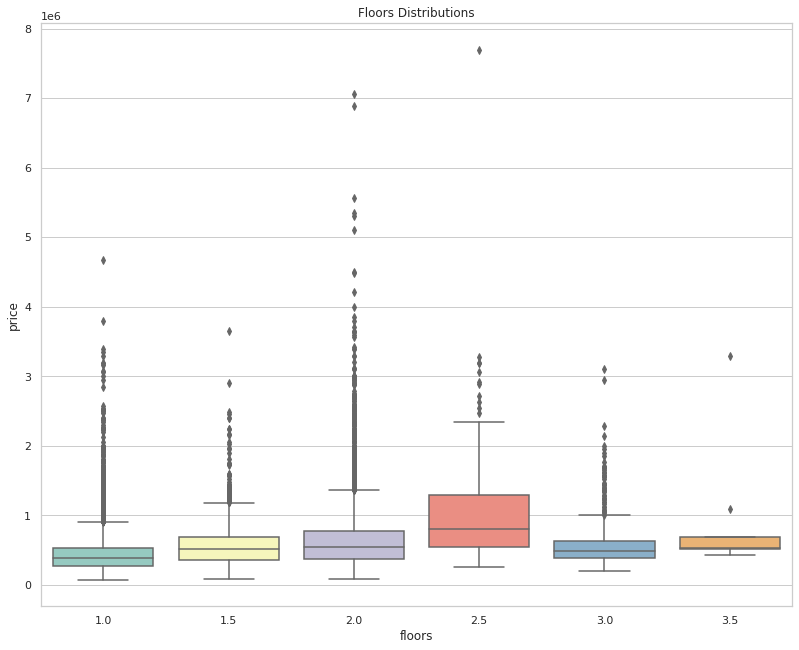

In [56]:
plt.figure(figsize=(12,10))
sns.set_theme(style="whitegrid")
sns.boxplot(x="floors", y="price", data=df, palette="Set3")
plt.title("Floors Distributions")

In [57]:
df.groupby('floors').price.max()

floors
1.0    4668000.0
1.5    3650000.0
2.0    7062500.0
2.5    7700000.0
3.0    3100000.0
3.5    3300000.0
Name: price, dtype: float64

In [58]:
df.groupby('floors').price.median()

floors
1.0    390000.0
1.5    524475.0
2.0    542975.0
2.5    799200.0
3.0    490000.0
3.5    534500.0
Name: price, dtype: float64

In [59]:
df[["floors","price"]].corr()

,floors,price
floors,1.000000,0.256818
price,0.256818,1.000000


#### Inference: 
On considering only floors, we are having positive correlation, but its small only. We can checkout the upcoming columns and will try to create a column - Feature Engineering


In [60]:
df.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'bathroom_category'], dtype='object')

## 9. Waterfront

A dummy variable for whether the apartment was overlooking the waterfront or not

In [61]:
df.waterfront.unique()

array([0, 1])

In [62]:
df.waterfront.corr(df.price)

0.2663708796395975

Text(0.5, 1.0, 'Waterfront Distributions')

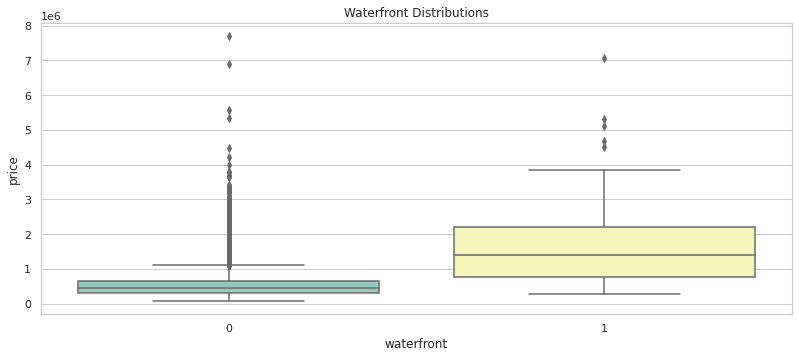

In [63]:
plt.figure(figsize=(12,5))
sns.set_theme(style="whitegrid")
sns.boxplot(x="waterfront", y="price", data=df, palette="Set3")
plt.title("Waterfront Distributions")

In [64]:
df.waterfront.value_counts()

0    21448
1      163
Name: waterfront, dtype: int64

#### Inference:
Its also having less positive correlation. We can check this in feature engineering.

## 10. View vs Price

An index from 0 to 4 of how good the view of the property was

In [65]:
df.view.unique()

array([0, 3, 4, 2, 1])

<AxesSubplot:xlabel='view'>

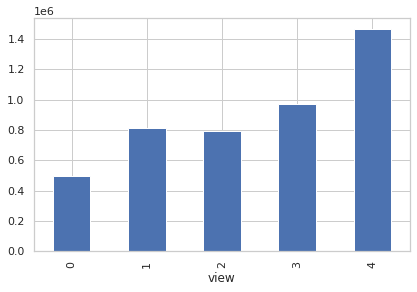

In [66]:
df.groupby("view").price.mean().plot(kind="bar")

Text(0.5, 1.0, 'View Distributions')

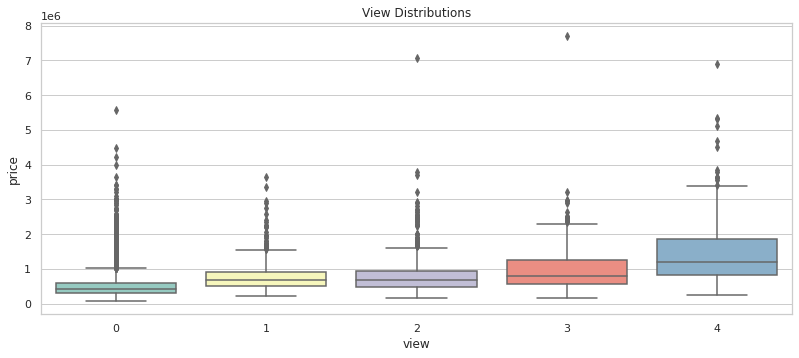

In [67]:
plt.figure(figsize=(12,5))
sns.set_theme(style="whitegrid")
sns.boxplot(x="view", y="price", data=df, palette="Set3")
plt.title("View Distributions")

In [68]:
df[["view","price"]].corr()

,view,price
view,1.000000,0.397299
price,0.397299,1.000000


#### Inference
View is having a good corelation of 39.7 %

## 11. Condition vs Price 

An index from 1 to 5 on the condition of the apartment,

In [69]:
df.condition.unique()

array([3, 5, 4, 1, 2])

<AxesSubplot:xlabel='condition'>

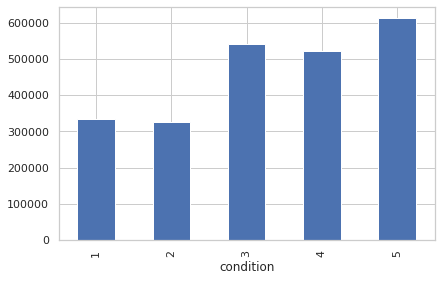

In [70]:
df.groupby("condition").price.mean().plot(kind="bar")

Text(0.5, 1.0, 'Condition Distributions')

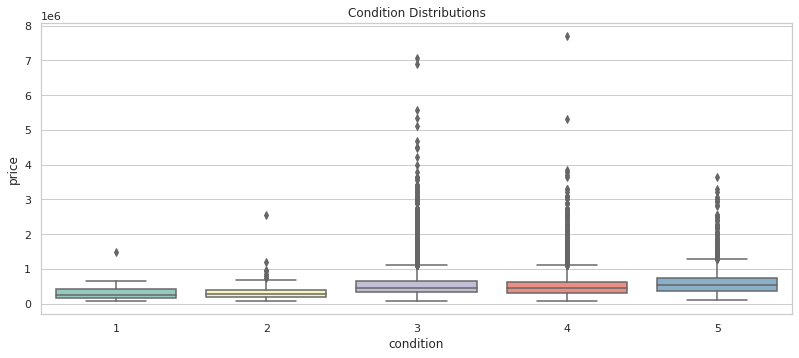

In [71]:
plt.figure(figsize=(12,5))
sns.set_theme(style="whitegrid")
sns.boxplot(x="condition", y="price", data=df, palette="Set3")
plt.title("Condition Distributions")

In [72]:
df[["condition","price"]].corr()

,condition,price
condition,1.000000,0.036335
price,0.036335,1.000000


#### Inference:
The reason for low corelation is, median is almost in a common range. Since its low we can ignore it. 

## 12. Grade vs Price

 An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.

In [73]:
df.grade.unique()

array([ 7,  6,  8, 11,  9,  5, 10, 12,  4,  3, 13,  1])

<AxesSubplot:xlabel='grade'>

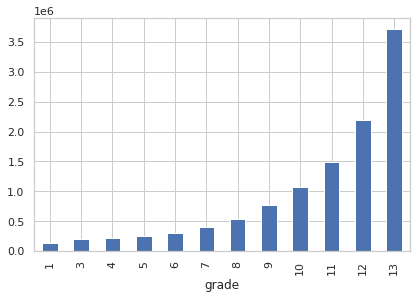

In [74]:
df.groupby("grade").price.mean().plot(kind="bar")

In [75]:
df.grade.corr(df.price)

0.6674507137957147

#### Inference:
Grade is having a good Correlation of 66.7%

## 13. Sqft Above vs Price

The square footage of the interior housing space that is above ground level

In [76]:
df.sqft_above.dtype

dtype('int64')

In [77]:
df[["sqft_above","price"]]

,sqft_above,price
0,1180,221900.0
1,2170,538000.0
2,770,180000.0
3,1050,604000.0
4,1680,510000.0
...,...,...
21608,1530,360000.0
21609,2310,400000.0
21610,1020,402101.0
21611,1600,400000.0


In [78]:
df[["sqft_above","price"]].corr()

,sqft_above,price
sqft_above,1.000000,0.605601
price,0.605601,1.000000


<AxesSubplot:xlabel='sqft_above', ylabel='price'>

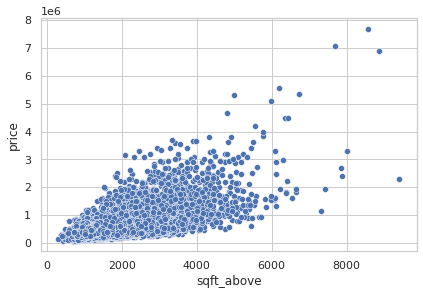

In [79]:
sns.scatterplot(data=df, x="sqft_above", y="price")

<AxesSubplot:xlabel='sqft_above', ylabel='price'>

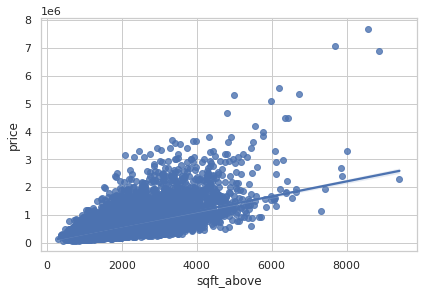

In [80]:
sns.regplot(data=df, x="sqft_above", y="price")

#### Inference:
Relation between Sqft_above and Price is good. 60.5 %

## 14. Sqft Basement vs Price

 The square footage of the interior housing space that is below ground level

In [81]:
df.sqft_basement.dtype

dtype('int64')

In [82]:
df[["sqft_basement","price"]]

,sqft_basement,price
0,0,221900.0
1,400,538000.0
2,0,180000.0
3,910,604000.0
4,0,510000.0
...,...,...
21608,0,360000.0
21609,0,400000.0
21610,0,402101.0
21611,0,400000.0


<AxesSubplot:xlabel='sqft_basement', ylabel='price'>

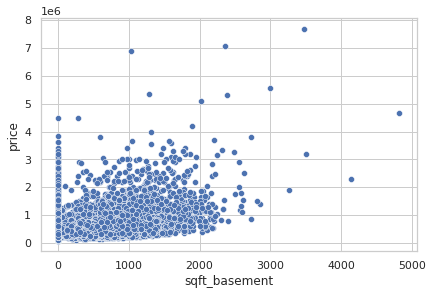

In [83]:
sns.scatterplot(data=df, x="sqft_basement", y="price")

<AxesSubplot:xlabel='sqft_basement', ylabel='price'>

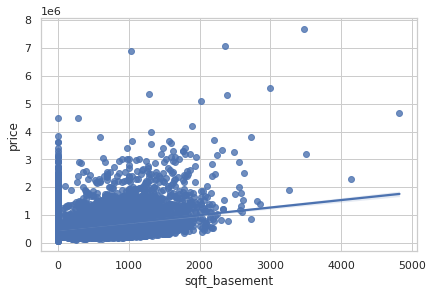

In [84]:
sns.regplot(data=df, x="sqft_basement", y="price")

In [85]:
df[["sqft_basement","price"]].corr()

,sqft_basement,price
sqft_basement,1.000000,0.323817
price,0.323817,1.000000


#### Inference:
Sqft Basement is having a good correlation of 32.3%

## 15. Yr_built vs Price

The year the house was initially built

In [86]:
df.yr_built.unique()

array([1955, 1951, 1933, 1965, 1987, 2001, 1995, 1963, 1960, 2003, 1942,
       1927, 1977, 1900, 1979, 1994, 1916, 1921, 1969, 1947, 1968, 1985,
       1941, 1915, 1909, 1948, 2005, 1929, 1981, 1930, 1904, 1996, 2000,
       1984, 2014, 1922, 1959, 1966, 1953, 1950, 2008, 1991, 1954, 1973,
       1925, 1989, 1972, 1986, 1956, 2002, 1992, 1964, 1952, 1961, 2006,
       1988, 1962, 1939, 1946, 1967, 1975, 1980, 1910, 1983, 1978, 1905,
       1971, 2010, 1945, 1924, 1990, 1914, 1926, 2004, 1923, 2007, 1976,
       1949, 1999, 1901, 1993, 1920, 1997, 1943, 1957, 1940, 1918, 1928,
       1974, 1911, 1936, 1937, 1982, 1908, 1931, 1998, 1913, 2013, 1907,
       1958, 2012, 1912, 2011, 1917, 1932, 1944, 1902, 2009, 1903, 1970,
       2015, 1934, 1938, 1919, 1906, 1935])

In [87]:
df.yr_built.value_counts()

2014    559
2006    454
2005    450
2004    433
2003    422
       ... 
1933     30
1901     29
1902     27
1935     24
1934     21
Name: yr_built, Length: 116, dtype: int64

In [88]:
df[["yr_built","price"]]

,yr_built,price
0,1955,221900.0
1,1951,538000.0
2,1933,180000.0
3,1965,604000.0
4,1987,510000.0
...,...,...
21608,2009,360000.0
21609,2014,400000.0
21610,2009,402101.0
21611,2004,400000.0


In [89]:
df[["yr_built","price"]].corr()

,yr_built,price
yr_built,1.000000,0.054022
price,0.054022,1.000000


#### Inference: 
Yr_built is having very less positive corelation.

## 16. Yr_renovated vs Price

The year of the house’s last renovation

In [90]:
df.yr_renovated.unique()

array([   0, 1991, 2002, 2010, 1999, 1992, 2013, 1994, 1978, 2005, 2008,
       2003, 1984, 1954, 2014, 2011, 1974, 1983, 1945, 1990, 1988, 1957,
       1977, 1981, 1995, 2000, 1998, 1970, 1989, 2004, 1986, 2009, 2007,
       1987, 1973, 2006, 1985, 2001, 1980, 1971, 1979, 1997, 1950, 1969,
       1948, 2015, 1968, 2012, 1963, 1951, 1993, 1962, 1996, 1972, 1953,
       1955, 1982, 1956, 1940, 1976, 1946, 1975, 1958, 1964, 1959, 1960,
       1967, 1965, 1934, 1944])

In [91]:
df[df.yr_renovated==0]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,bathroom_category
0,7129300520,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,1.00
2,5631500400,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,1.00
3,2487200875,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,3.00
4,1954400510,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,2.00
5,7237550310,2014-05-12,1225000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930,4.50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,2014-05-21,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509,2.50
21609,6600060120,2015-02-23,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200,2.50
21610,1523300141,2014-06-23,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007,0.75
21611,291310100,2015-01-16,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287,2.50


In [92]:
df[["yr_renovated","price"]].corr()

,yr_renovated,price
yr_renovated,1.000000,0.126515
price,0.126515,1.000000


#### Inference: 
Yr Renovated is also having very less positive correlation

## 17. Zipcode vs Price

We wont be buying a house on any places. If the place/locality is good then only we will start thinking about buying and all attributes related.

In [93]:
df.zipcode.unique()

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039])

In [94]:
df.zipcode.value_counts()

98103    601
98038    590
98115    583
98052    574
98117    553
        ... 
98102    105
98010    100
98024     81
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

In [95]:
df[["zipcode","price"]].corr()

,zipcode,price
zipcode,1.000000,-0.053208
price,-0.053208,1.000000


#### Inference:
Zipcode is having a negative correlation. 

## 18. Lat Long 

Just Coordinates. 

In [96]:
df[["lat","long"]]

,lat,long
0,47.5112,-122.257
1,47.7210,-122.319
2,47.7379,-122.233
3,47.5208,-122.393
4,47.6168,-122.045
...,...,...
21608,47.6993,-122.346
21609,47.5107,-122.362
21610,47.5944,-122.299
21611,47.5345,-122.069


In [97]:
from glob import glob
from folium import plugins
from folium.plugins import HeatMap


m = folium.Map([47, -122], tiles='stamentoner', zoom_start=6)
data = df[["lat","long"]].values.tolist()
HeatMap(data).add_to(folium.FeatureGroup(name='Heat Map').add_to(m))
folium.LayerControl().add_to(m)

m

In [98]:
for index, row in df.iterrows():
    folium.CircleMarker([row['lat'], row['long']],
                        radius=15,
                        popup=row['price'],
                        fill_color="#3db7e4",
                       ).add_to(m)
m

## 19. Sqft_living15

 The square footage of interior housing living space for the nearest 15 neighbors

In [99]:
df.sqft_living15.dtype

dtype('int64')

In [100]:
df[["sqft_living15", "price"]]

,sqft_living15,price
0,1340,221900.0
1,1690,538000.0
2,2720,180000.0
3,1360,604000.0
4,1800,510000.0
...,...,...
21608,1530,360000.0
21609,1830,400000.0
21610,1020,402101.0
21611,1410,400000.0


<AxesSubplot:xlabel='sqft_living15', ylabel='price'>

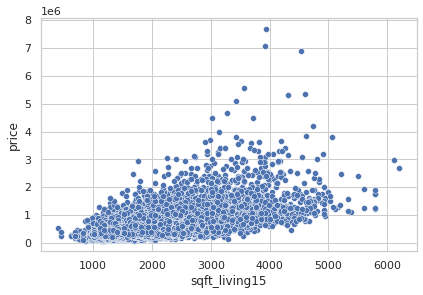

In [101]:
sns.scatterplot(data=df, x="sqft_living15", y="price")

<AxesSubplot:xlabel='sqft_living15', ylabel='price'>

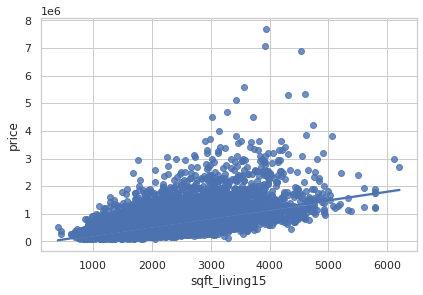

In [102]:
sns.regplot(data=df, x="sqft_living15", y="price")

In [103]:
df[["sqft_living15", "price"]].corr()

,sqft_living15,price
sqft_living15,1.000000,0.585412
price,0.585412,1.000000


#### Inference:
Sqft_living is having good Corr with Price. about 58.5 %

## 20. Sqft_lot15

The square footage of the land lots of the nearest 15 neighbors

In [104]:
df.sqft_lot15.dtype

dtype('int64')

In [105]:
df[["sqft_lot15", "price"]]

,sqft_lot15,price
0,5650,221900.0
1,7639,538000.0
2,8062,180000.0
3,5000,604000.0
4,7503,510000.0
...,...,...
21608,1509,360000.0
21609,7200,400000.0
21610,2007,402101.0
21611,1287,400000.0


<AxesSubplot:xlabel='sqft_lot15', ylabel='price'>

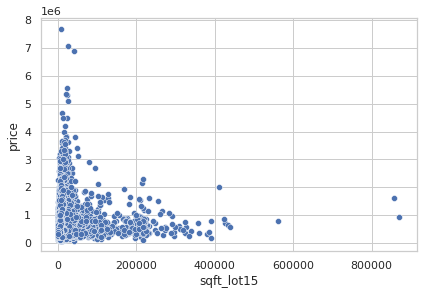

In [106]:
sns.scatterplot(data=df, x="sqft_lot15", y="price")

<AxesSubplot:xlabel='sqft_lot15', ylabel='price'>

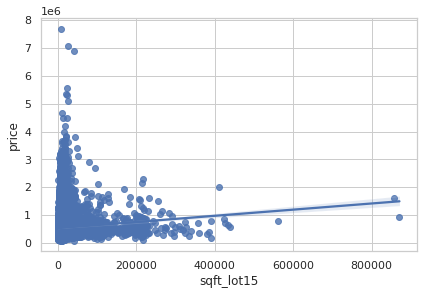

In [107]:
sns.regplot(data=df, x="sqft_lot15", y="price")

In [108]:
df[["sqft_lot15","price"]].corr()

,sqft_lot15,price
sqft_lot15,1.000000,0.082451
price,0.082451,1.000000


#### Inference:
Its having very less positive correlation

# 4. Feature Engineering

## 1. Overview of the above Data Preparation

1. No Null Values. 
2. We will be concentrating only on 
     1. ✅ Bedroom
     2. ✅ Bathrooms
     3. ✅ SqftLiving
     4. ✅ Floors
     5. ✅ Waterfront
     6. ✅ View
     7. ✅ Grade
     8. ✅ SqftAbove
     9. ✅ sqft_basement
     10. ✅ sqft_living15
3. Possible feature engineering in , 
    1. Bedroom and Bathroom
    2. Floors
    3. View
    4. Condition
    5. YrBuilt and Year Renovation
    6. Zipcode with Lat Long -> Clustering a particular area
 

## 2. Analysing the data

In [109]:
fltrd_df = df[["bedrooms",'bathrooms','sqft_living',"floors","waterfront","view","grade","sqft_above","sqft_basement", "condition","yr_built","yr_renovated", "zipcode","lat","long","price"]]

In [110]:
fltrd_df

,bedrooms,bathrooms,sqft_living,floors,waterfront,view,grade,sqft_above,sqft_basement,condition,yr_built,yr_renovated,zipcode,lat,long,price
0,3,1.00,1180,1.0,0,0,7,1180,0,3,1955,0,98178,47.5112,-122.257,221900.0
1,3,2.25,2570,2.0,0,0,7,2170,400,3,1951,1991,98125,47.7210,-122.319,538000.0
2,2,1.00,770,1.0,0,0,6,770,0,3,1933,0,98028,47.7379,-122.233,180000.0
3,4,3.00,1960,1.0,0,0,7,1050,910,5,1965,0,98136,47.5208,-122.393,604000.0
4,3,2.00,1680,1.0,0,0,8,1680,0,3,1987,0,98074,47.6168,-122.045,510000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,3,2.50,1530,3.0,0,0,8,1530,0,3,2009,0,98103,47.6993,-122.346,360000.0
21609,4,2.50,2310,2.0,0,0,8,2310,0,3,2014,0,98146,47.5107,-122.362,400000.0
21610,2,0.75,1020,2.0,0,0,7,1020,0,3,2009,0,98144,47.5944,-122.299,402101.0
21611,3,2.50,1600,2.0,0,0,8,1600,0,3,2004,0,98027,47.5345,-122.069,400000.0


## 3. Year Built and Renovated

In [111]:
fltrd_df[["yr_built","yr_renovated"]]

,yr_built,yr_renovated
0,1955,0
1,1951,1991
2,1933,0
3,1965,0
4,1987,0
...,...,...
21608,2009,0
21609,2014,0
21610,2009,0
21611,2004,0


We can create a new column with the below logic, 
1. yr_gap -> yr_renovated - yr_built
2. if yr_renovated is zero we can put -1

In [112]:
fltrd_df["yr_gap"] = fltrd_df["yr_renovated"] - fltrd_df["yr_built"]
fltrd_df["yr_gap"] = fltrd_df["yr_gap"].apply(lambda x : x if x >=0 else -1)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [113]:
fltrd_df["yr_gap"].corr(fltrd_df["price"])

0.11853628562411807

In [114]:
fltrd_df.yr_gap.unique()

array([ -1,  40,  72,  45,  60,  99,  78,  97,  74,  34,  63, 101,  26,
        49,  89,  62,  51, 110, 102,  27,  38,  22,  53,  85,  31,  77,
        93,  18,  66,  21,  91,  75,  44,  28,  48,  46,  29,  58,  70,
        32,  56,  65,  47,  57,   9,  35,  82,  76,  61,  59,  87,  30,
        86, 108, 103,  79,  12,  37,  98,  16,  69,  94,  33,  43,  39,
        88,  71, 109, 114,  81,  84,  64, 104,  68,  90,  83,  41,  73,
        52,  36,  24, 105,  67,  15,  55,  42,  25,  17,   8,  50,  19,
        23,  54,  20,  80,  96, 100,  95,  92, 113,  11,   6,  14,  13,
       107,  10])

#### adding a buffer of 5 , we can split the categories. 

In [115]:
def apply_gap_in_yr(x):
    if x >= 0 and x <= 10:
        return 1
    elif x >= 11 and x <= 20:
        return 2
    elif x>=21 and x<=30:
        return 3
    elif x>=31 and x<=40:
        return 4
    elif x>=41 and x<=50:
        return 5
    elif x>=51 and x<=60:
        return 6
    elif x>=61 and x<=70:
        return 7
    elif x>=71 and x<=80:
        return 8
    elif x>=81 and x<=90:
        return 9
    elif x>=91 and x<=100:
        return 10
    elif x>=101:
        return 11
    else:
        return x

In [116]:
fltrd_df["yr_gap"] = fltrd_df["yr_gap"].apply(apply_gap_in_yr)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [117]:
fltrd_df.groupby("yr_gap").price.max()

yr_gap
-1     6885000.0
 1     2160000.0
 2     2500000.0
 3     4668000.0
 4     2888000.0
 5     2525000.0
 6     2750000.0
 7     7062500.0
 8     7700000.0
 9     3000000.0
 10    2193000.0
 11    1755000.0
Name: price, dtype: float64

In [118]:
fltrd_df["yr_gap"].corr(fltrd_df["price"])

0.12148514963971661

<AxesSubplot:>

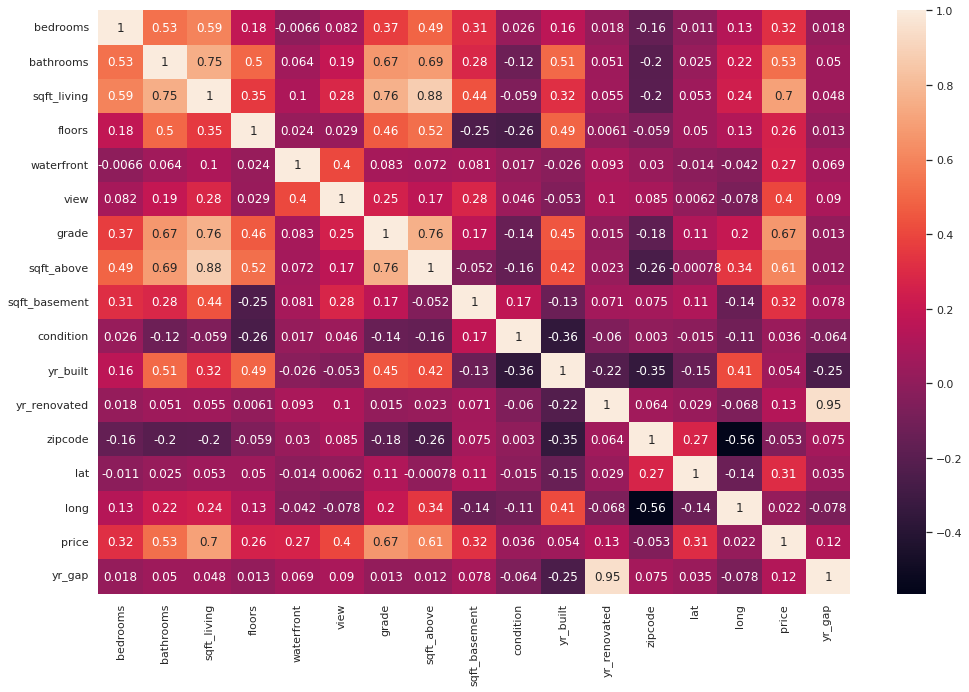

In [119]:
plt.figure(figsize=(15,10))
sns.heatmap(fltrd_df.corr(), annot = True)

# 5. Model Preparation

In [120]:
# Model Imports
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [121]:
models_data = []

## 1. Univariate Model 

Considering sqft_living, since it has more correlation than others. 

(0.0, 8084034.82865129)

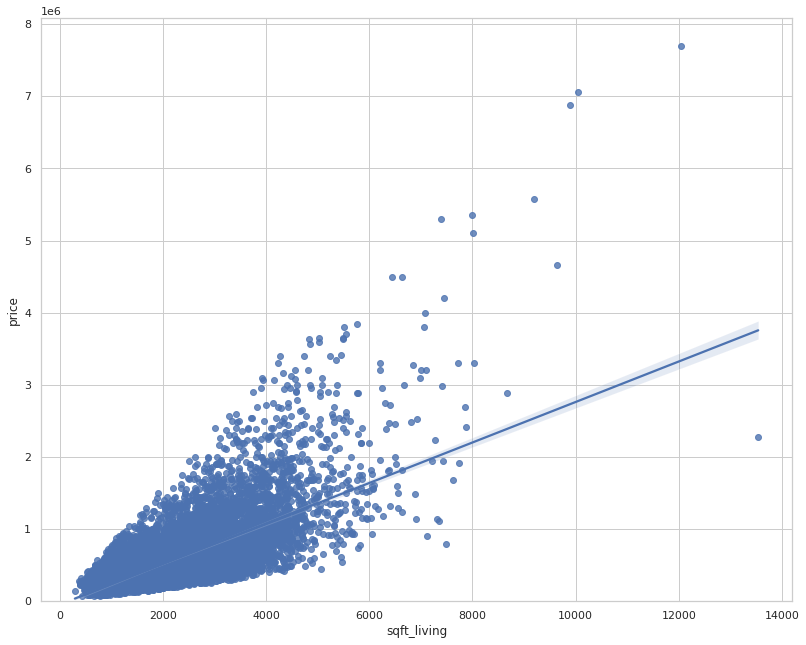

In [122]:
width = 12
height = 10
plt.figure(figsize=(width, height))
sns.regplot(x="sqft_living", y="price", data=fltrd_df)
plt.ylim(0,)

In [123]:
X = fltrd_df[["sqft_living"]]
Y = fltrd_df[["price"]]
lr = LinearRegression()
lr.fit(X, Y)

print(lr.coef_, lr.intercept_)
print(lr.predict(X.head()))

print(Y.head())

print("Final Score", lr.score(X, Y))

[[280.64339079]] [-43619.69015156]
[[287539.51097693]
 [677633.82417065]
 [172475.72075432]
 [506441.35579067]
 [427861.20637035]]
      price
0  221900.0
1  538000.0
2  180000.0
3  604000.0
4  510000.0
Final Score 0.49289599743351


In [124]:
X = fltrd_df[["grade"]]
Y = fltrd_df[["price"]]
lr = LinearRegression()
lr.fit(X, Y)

print(lr.coef_, lr.intercept_)
print(lr.predict(X.head()))

print(Y.head())

print("Final Score", lr.score(X, Y))

[[208465.34354109]] [-1056120.92217477]
[[403136.48261289]
 [403136.48261289]
 [194671.13907179]
 [403136.48261289]
 [611601.82615398]]
      price
0  221900.0
1  538000.0
2  180000.0
3  604000.0
4  510000.0
Final Score 0.4454904553464101


In [125]:
X = fltrd_df[["bathrooms"]]
Y = fltrd_df[["price"]]
lr = LinearRegression()
lr.fit(X, Y)

print(lr.coef_, lr.intercept_)
print(lr.predict(X.head()))

print(Y.head())

print("Final Score", lr.score(X, Y))

[[250348.64898033]] [10663.83909239]
[[261012.48807271]
 [573948.29929812]
 [261012.48807271]
 [761709.78603337]
 [511361.13705304]]
      price
0  221900.0
1  538000.0
2  180000.0
3  604000.0
4  510000.0
Final Score 0.275799425482417


In [126]:
X = fltrd_df[["view"]]
Y = fltrd_df[["price"]]
lr = LinearRegression()
lr.fit(X, Y)

print(lr.coef_, lr.intercept_)
print(lr.predict(X.head()))

print(Y.head())

print("Final Score", lr.score(X, Y))

[[190338.36852748]] [495483.3885418]
[[495483.3885418]
 [495483.3885418]
 [495483.3885418]
 [495483.3885418]
 [495483.3885418]]
      price
0  221900.0
1  538000.0
2  180000.0
3  604000.0
4  510000.0
Final Score 0.15784648873937934


## 2. Multivariate

In [127]:
X = fltrd_df.drop(["waterfront", "condition", "yr_built", "zipcode","lat","long", "price"], axis=1)
Y = fltrd_df["price"]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.30, random_state=42)



In [128]:
X.head()

,bedrooms,bathrooms,sqft_living,floors,view,grade,sqft_above,sqft_basement,yr_renovated,yr_gap
0,3,1.00,1180,1.0,0,7,1180,0,0,-1
1,3,2.25,2570,2.0,0,7,2170,400,1991,4
2,2,1.00,770,1.0,0,6,770,0,0,-1
3,4,3.00,1960,1.0,0,7,1050,910,0,-1
4,3,2.00,1680,1.0,0,8,1680,0,0,-1


In [129]:
lr = LinearRegression()
lr.fit(X_train,y_train)
lr.score(X_train, y_train)

0.5910126950648708

In [130]:
# Training data
y_hat = lr.predict(X_train)
print("MSE", mean_squared_error(y_train, y_hat))
print("MAE", mean_absolute_error(y_train, y_hat))
print("Score", r2_score(y_train, y_hat))

MSE 54493211221.67108
MAE 152386.0294788288
Score 0.5910126950648708


In [131]:
# Testing data
y_hat = lr.predict(X_test)
print("MSE", mean_squared_error(y_test, y_hat))
print("MAE", mean_absolute_error(y_test, y_hat))
print("Score", r2_score(y_test, y_hat))

MSE 58575078976.89826
MAE 158378.06576227327
Score 0.5767014906287298


In [132]:
lr.score(X_test,y_test)

0.5767014906287298

## 3. Polynomial

In [133]:
pr=PolynomialFeatures(degree=2)
pr

PolynomialFeatures()

In [134]:
X_pr = pr.fit_transform(X)

In [135]:
X_train_pr, X_test_pr, y_train, y_test = train_test_split(X_pr, Y, test_size=0.30, random_state=42)


In [136]:
lr = LinearRegression()
lr.fit(X_train,y_train)
lr.score(X_train, y_train)

0.5910126950648708

In [137]:
lr = LinearRegression()
lr.fit(X_train_pr,y_train)
lr.score(X_train_pr, y_train)
# after polynomial conversion accuracy had improved

0.6703684030737607

In [138]:
y_pred = lr.predict(X_pr)

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)


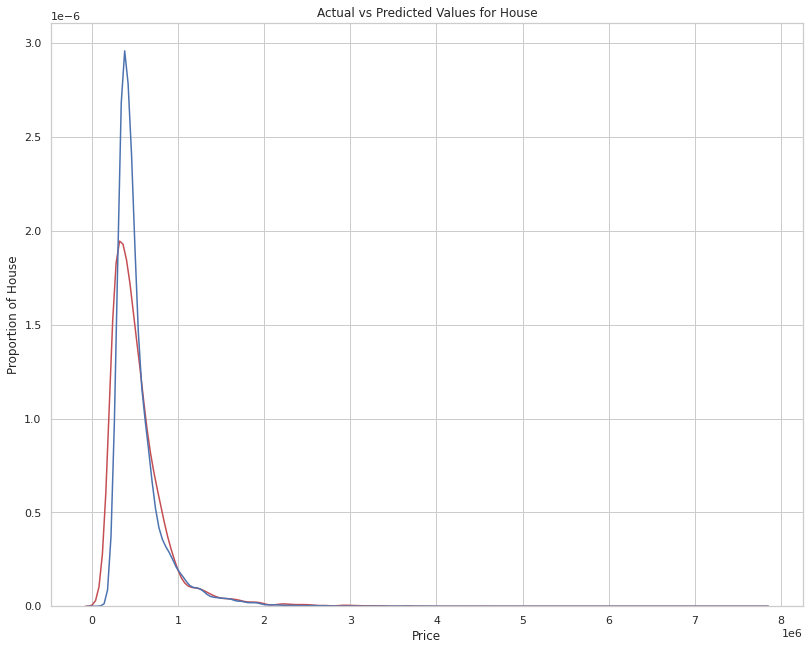

In [139]:
plt.figure(figsize=(12, 10))

ax1 = sns.distplot(fltrd_df['price'], hist=False, color="r", label="Actual Value") # hist=True
sns.distplot(y_pred, hist=False, color="b", label="Predicted Values" , ax=ax1)


plt.title('Actual vs Predicted Values for House')
plt.xlabel('Price')
plt.ylabel('Proportion of House')

plt.show()
plt.close()

In [140]:
y_hat = lr.predict(X_test_pr)
print("MSE", mean_squared_error(y_test, y_hat))
print("MAE", mean_absolute_error(y_test, y_hat))
print("Score", r2_score(y_test, y_hat))

MSE 50812066637.655014
MAE 147611.9524721168
Score 0.6328016548765399


## 4. Univariate with Normalization

In [141]:
X = fltrd_df[["sqft_living"]]
norm = MinMaxScaler()
X = norm.fit_transform(X)
Y = fltrd_df[["price"]]
lr = LinearRegression()
lr.fit(X, Y)

print(lr.coef_, lr.intercept_)
print(lr.predict(X[:5]))

print(Y.head())

print("Final Score", lr.score(X, Y))

[[3718524.92792581]] [37766.89317663]
[[287539.51097693]
 [677633.82417065]
 [172475.72075432]
 [506441.35579067]
 [427861.20637035]]
      price
0  221900.0
1  538000.0
2  180000.0
3  604000.0
4  510000.0
Final Score 0.49289599743350987


## 5. Polynomial Normalization with Regression

In [142]:
X = fltrd_df.drop(["waterfront", "condition", "yr_built", "zipcode","lat","long","price"], axis=1)
Y = fltrd_df["price"]

In [143]:
norm = MinMaxScaler()
pr = PolynomialFeatures(2)

In [144]:
X_norm = norm.fit_transform(X)
X_pr = pr.fit_transform(X_norm)

In [145]:
X_train_pr, X_test_pr, y_train, y_test = train_test_split(X_pr, Y, test_size=0.30, random_state=42)


In [146]:

lr_pr = LinearRegression()
lr_pr.fit(X_train_pr,y_train)
lr_pr.score(X_train_pr, y_train)
y_hat = lr_pr.predict(X_train_pr)
print("MSE", mean_squared_error(y_train, y_hat))
print("MAE", mean_absolute_error(y_train, y_hat))
print("Score", r2_score(y_train, y_hat))

MSE 43919906885.80148
MAE 140558.2745858341
Score 0.6703684009893274


In [147]:
X_train_pr.shape

(15127, 66)

In [148]:
X_test_pr.shape

(6484, 66)

In [149]:
y_hat = lr_pr.predict(X_test_pr)

In [150]:
# Testing data
print("MSE", mean_squared_error(y_test, y_hat))
print("MAE", mean_absolute_error(y_test, y_hat))
print("Score", r2_score(y_test, y_hat))

MSE 50812088346.7832
MAE 147612.87092169563
Score 0.6328014979934121


# Inference:
1. With Multivariate Linear Regression : 57 % Accuracy
2. With Polynomial Linear Regression : 63% Accuracy
3. With Polynomical Normalization Linear Regression : 63% Accuracy

# Unexplored Options:
1. Hypothesis: Cost of the house is dependant on the area (Near to public communities). We can use lat long to create a cluster of n numbers and based on that we can categorize the data and use it for predictions. 

2. We can find a relationship between bathroom and bedroom ; use it for predictions. 

## If you find any other interesting options please share it in comments. 
## If you like it, Click on the Upvote Button. 